<a href="https://colab.research.google.com/github/Ankit0003/Project/blob/main/Minor_project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install kaggle
!pip install gtts


import nltk
from keras.applications.resnet50 import ResNet50, preprocess_input
import tensorflow as tf
import numpy as np
import string
import keras
import json
import random
from time import time
from keras.layers import *
from keras.models import Model,load_model
from keras.preprocessing import image
import matplotlib.pyplot as plt
from keras.utils import to_categorical
from keras.layers import Input,Dense,Dropout,Embedding,LSTM
from keras.layers.merge import add
from keras.preprocessing.sequence import pad_sequences
from keras.applications.inception_v3 import InceptionV3
from keras import optimizers
from gtts import gTTS
import os
import sys
import cv2

from google.colab import files
files.upload()

!pip install -q kaggle
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!ls ~/.kaggle
!chmod 600 /root/.kaggle/kaggle.json

!kaggle datasets download -d adityajn105/flickr8k
!unzip flickr8k.zip


Streaming output truncated to the last 5000 lines.
  inflating: Images/2844846111_8c1cbfc75d.jpg  
  inflating: Images/2844963839_ff09cdb81f.jpg  
  inflating: Images/2845246160_d0d1bbd6f0.jpg  
  inflating: Images/2845691057_d4ab89d889.jpg  
  inflating: Images/2845845721_d0bc113ff7.jpg  
  inflating: Images/2846037553_1a1de50709.jpg  
  inflating: Images/2846785268_904c5fcf9f.jpg  
  inflating: Images/2846843520_b0e6211478.jpg  
  inflating: Images/2847514745_9a35493023.jpg  
  inflating: Images/2847615962_c330bded6e.jpg  
  inflating: Images/2847859796_4d9cb0d31f.jpg  
  inflating: Images/2848266893_9693c66275.jpg  
  inflating: Images/2848571082_26454cb981.jpg  
  inflating: Images/2848895544_6d06210e9d.jpg  
  inflating: Images/2848977044_446a31d86e.jpg  
  inflating: Images/2849194983_2968c72832.jpg  
  inflating: Images/2850719435_221f15e951.jpg  
  inflating: Images/2851198725_37b6027625.jpg  
  inflating: Images/2851304910_b5721199bc.jpg  
  inflating: Images/2851931813_eaf8ed

In [ ]:
import pickle

def readTextFile(path):
    with open(path) as f:
        cap = f.read()
    return cap



In [ ]:
cap = readTextFile("captions.txt")
cap = cap.split('\n')[:-1]
cap = cap[1:]

final_cap = []
for ix,x in enumerate(cap):
  cnt=0;
  st = ""
  for iy,y in enumerate(x):
    if y==',':
      if cnt==1:
        continue
      cnt = 1
    st = st+y
  final_cap.append(st)
cap = final_cap

In [ ]:
cap

['1000268201_693b08cb0e.jpg,A child in a pink dress is climbing up a set of stairs in an entry way .',
 '1000268201_693b08cb0e.jpg,A girl going into a wooden building .',
 '1000268201_693b08cb0e.jpg,A little girl climbing into a wooden playhouse .',
 '1000268201_693b08cb0e.jpg,A little girl climbing the stairs to her playhouse .',
 '1000268201_693b08cb0e.jpg,A little girl in a pink dress going into a wooden cabin .',
 '1001773457_577c3a7d70.jpg,A black dog and a spotted dog are fighting',
 '1001773457_577c3a7d70.jpg,A black dog and a tri-colored dog playing with each other on the road .',
 '1001773457_577c3a7d70.jpg,A black dog and a white dog with brown spots are staring at each other in the street .',
 '1001773457_577c3a7d70.jpg,Two dogs of different breeds looking at each other on the road .',
 '1001773457_577c3a7d70.jpg,Two dogs on pavement moving toward each other .',
 '1002674143_1b742ab4b8.jpg,A little girl covered in paint sits in front of a painted rainbow with her hands in a 

In [ ]:
mapping = {}
file = open("./drive/MyDrive/Flickr_TextData/train.txt","w")
for x in cap:
  
    f,sec = x.split(',')

    im_ka_name = f.split('.')[0]
    
    if mapping.get(im_ka_name) is None:
        mapping[im_ka_name] = []
    
    mapping[im_ka_name].append(sec)
    file.write(im_ka_name+"\n")

In [ ]:
uni_words = set()

for key in mapping.keys():
    [uni_words.update(sen.split()) for sen in mapping[key]]

In [ ]:
words = []
for key in mapping.keys():
    [words.append(i) for j in mapping[key] for i in j.split()]
    

In [ ]:

fr_cnt = dict()
for w in words:
    if w in fr_cnt:
        fr_cnt[w] += 1
    else:
        fr_cnt[w] = 1

print(len(fr_cnt.keys()))

9861


In [ ]:
sorted_fr_cnt = sorted(fr_cnt.items(),reverse=True,key=lambda x:x[1])

In [ ]:
len(sorted_fr_cnt)

9861

In [ ]:
lim = 10
sorted_fr_cnt = [x for x in sorted_fr_cnt if x[1]>lim]
len(sorted_fr_cnt)

1920

In [ ]:
final_words = [x[0] for x in sorted_fr_cnt]

In [ ]:
len(final_words)

1920

In [ ]:
tr1 = readTextFile("./drive/MyDrive/Flickr_TextData/train.txt")

In [ ]:
tr = [row.split(".")[0] for row in tr1.split("\n")[:-1]]
tr_final = []
for ix,p in enumerate(tr):
  if ix == 10000:
    break
  tr_final.append(p)
print(len(tr_final))

10000


In [ ]:
desc_tr = {}
cnt = 0
for im_ka_id in tr_final:
    
    desc_tr[im_ka_id] = []
    for cap in mapping[im_ka_id]:
        
        to_app = "startseq " + cap + " endseq"
        desc_tr[im_ka_id].append(to_app)
desc_tr.keys() 
#desc_tr["2513260012_03d33305cf"] 

dict_keys(['1000268201_693b08cb0e', '1001773457_577c3a7d70', '1002674143_1b742ab4b8', '1003163366_44323f5815', '1007129816_e794419615', '1007320043_627395c3d8', '1009434119_febe49276a', '1012212859_01547e3f17', '1015118661_980735411b', '1015584366_dfcec3c85a', '101654506_8eb26cfb60', '101669240_b2d3e7f17b', '1016887272_03199f49c4', '1019077836_6fc9b15408', '1019604187_d087bf9a5f', '1020651753_06077ec457', '1022454332_6af2c1449a', '1022454428_b6b660a67b', '1022975728_75515238d8', '102351840_323e3de834', '1024138940_f1fefbdce1', '102455176_5f8ead62d5', '1026685415_0431cbf574', '1028205764_7e8df9a2ea', '1030985833_b0902ea560', '103106960_e8a41d64f8', '103195344_5d2dc613a3', '103205630_682ca7285b', '1032122270_ea6f0beedb', '1032460886_4a598ed535', '1034276567_49bb87c51c', '104136873_5b5d41be75', '1042020065_fb3d3ba5ba', '1042590306_95dea0916c', '1045521051_108ebc19be', '1048710776_bb5b0a5c7c', '1052358063_eae6744153', '105342180_4d4a40b47f', '1053804096_ad278b25f1', '1055623002_8195a43714'

In [ ]:
model = ResNet50(weights="imagenet",input_shape=(224,224,3))
model.summary()

102973440/102967424 [==============================] - 1s 0us/step
Model: "resnet50"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv1_pad (ZeroPadding2D)       (None, 230, 230, 3)  0           input_1[0][0]                    
__________________________________________________________________________________________________
conv1_conv (Conv2D)             (None, 112, 112, 64) 9472        conv1_pad[0][0]                  
__________________________________________________________________________________________________
conv1_bn (BatchNormalization)   (None, 112, 112, 64) 256         conv1_conv[0][0]                 
________________________

In [ ]:
model_new = Model(model.input,model.layers[-2].output)

In [ ]:
def prepro_img(im1):
    im1 = image.load_img(im1,target_size=(224,224))
    im1 = image.img_to_array(im1)
    im1 = np.expand_dims(im1,axis=0)
    #Normalisation
    im1 = preprocess_input(im1)
    return im1

In [ ]:
def encoder(im3):
    im3 = prepro_img(im3)
    feature_vector = model_new.predict(im3)
    #print(feature_vector.shape)
    feature_vector = feature_vector.reshape((-1,))
    #print(feature_vector.shape)
    return feature_vector

In [ ]:
#tr_enc = {}

#for ix,img_ka_id in enumerate(tr_final):
    #img_ka_path = img_ka_id + ".jpg"
    
    #tr_enc[img_ka_path] = encoder("Images/"+img_ka_path)
#print(tr_enc["1000268201_693b08cb0e.jpg"])

In [ ]:
f = open("./drive/MyDrive/enc_features.pkl", "rb")

tr_enc = pickle.load(f)
print(tr_enc["1000268201_693b08cb0e.jpg"])

[0.06535943 0.16782558 0.32517594 ... 0.05107141 0.32821158 1.0043379 ]


In [ ]:
word_to_idx = {}
idx_to_word = {}

for i,word in enumerate(final_words):
    word_to_idx[word] = i+1
    idx_to_word[i+1] = word

In [ ]:
print(len(idx_to_word))

1920


In [ ]:
word_to_idx["startseq"] = 1921
idx_to_word[1921] = "startseq"

word_to_idx["endseq"] = 1922
idx_to_word[1922] = "endseq"


In [ ]:
word_size = len(word_to_idx)+1

In [ ]:
mx = 0

for key in desc_tr.keys():
    for cap in desc_tr[key]:
        mx = max(mx,len(cap.split()))

mx
print(mx)


39


In [ ]:
def data_generator1(desc_tr,tr_enc,word_to_idx,mx,batch_size):
    A1,A2,y = [],[],[]
    
    n = 0
    while True:
        for key,desc_list in desc_tr.items():
            n += 1
               
            photo = tr_enc[key+".jpg"]
        #    photo = photo/255.0
           # print(photo.shape)
           # plt.imshow(photo)
            for desc in desc_list:
                p = [word_to_idx[word] for word in desc.split(' ') if word in word_to_idx]
                
                for i in range(1,len(p)):
                    part1 = p[0:i]
                    part2 = p[i]
                    
                    part1 = pad_sequences([part1],maxlen=mx,value=0,padding='post')[0]
                    part2 = to_categorical([part2],num_classes=word_size)[0] #to_categorical is used for making 1 hot vector
                    
                    A1.append(photo)
                    A2.append(part1)
                    y.append(part2)
                    
                   
                if n==batch_size:
                    yield {"img_input":np.array(A1),"cap_input":np.array(A2)},np.array(y)
                        
                    A1,A2,y = [],[],[]
                    n = 0

In [ ]:
f = open("./drive/MyDrive/Glove/glove.6B.50d.txt",encoding='utf8')

In [ ]:
embedd_index = {}

for line in f:
    values = line.split()
    print(values)
    word = values[0]
    word_embedd = np.array(values[1:],dtype='float')
    embedd_index[word] = word_embedd

['the', '0.418', '0.24968', '-0.41242', '0.1217', '0.34527', '-0.044457', '-0.49688', '-0.17862', '-0.00066023', '-0.6566', '0.27843', '-0.14767', '-0.55677', '0.14658', '-0.0095095', '0.011658', '0.10204', '-0.12792', '-0.8443', '-0.12181', '-0.016801', '-0.33279', '-0.1552', '-0.23131', '-0.19181', '-1.8823', '-0.76746', '0.099051', '-0.42125', '-0.19526', '4.0071', '-0.18594', '-0.52287', '-0.31681', '0.00059213', '0.0074449', '0.17778', '-0.15897', '0.012041', '-0.054223', '-0.29871', '-0.15749', '-0.34758', '-0.045637', '-0.44251', '0.18785', '0.0027849', '-0.18411', '-0.11514', '-0.78581']
[',', '0.013441', '0.23682', '-0.16899', '0.40951', '0.63812', '0.47709', '-0.42852', '-0.55641', '-0.364', '-0.23938', '0.13001', '-0.063734', '-0.39575', '-0.48162', '0.23291', '0.090201', '-0.13324', '0.078639', '-0.41634', '-0.15428', '0.10068', '0.48891', '0.31226', '-0.1252', '-0.037512', '-1.5179', '0.12612', '-0.02442', '-0.042961', '-0.28351', '3.5416', '-0.11956', '-0.014533', '-0.149

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




['aviator', '-0.30926', '0.86222', '-0.082364', '-0.83529', '0.040253', '-0.22871', '-1.0451', '-0.80555', '0.20984', '-0.5157', '0.81443', '0.89148', '0.26269', '1.0997', '-0.11962', '-1.0711', '-0.86735', '0.5745', '-1.6853', '-0.0014066', '-0.99541', '1.0031', '-0.98316', '-1.2688', '-0.11664', '-1.2158', '-1.0091', '-0.19788', '0.17856', '0.57007', '-0.56098', '-0.28158', '-0.59711', '-0.093552', '0.63492', '0.60098', '-0.20408', '0.21918', '-0.89534', '-0.87728', '0.69043', '0.66592', '1.3531', '-0.39087', '-0.39982', '-0.93814', '0.35659', '-0.84032', '-0.64615', '0.36015']
['signalling', '0.5329', '-0.062549', '0.70904', '-0.020099', '-0.63816', '0.15291', '0.62237', '-0.079676', '0.31705', '0.27822', '1.0737', '-0.011247', '-0.48687', '0.45462', '-1.1471', '1.074', '-0.80717', '-0.18565', '0.09179', '-0.18126', '0.56505', '-1.1042', '-0.51907', '0.24732', '0.39429', '-0.30274', '0.70923', '0.24479', '0.47843', '0.56968', '1.1791', '0.45056', '0.16572', '-0.92926', '0.46077', '

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['contrition', '0.24085', '0.20635', '-1.2162', '-0.38983', '0.49108', '0.43416', '1.2621', '0.43154', '-0.21793', '1.1809', '-0.088147', '0.3894', '0.12487', '-0.34574', '0.10205', '-0.27435', '-1.0435', '-0.28985', '0.51784', '-0.48862', '0.22357', '0.62625', '-0.10046', '-0.79759', '0.25911', '-0.23579', '-0.64071', '0.77789', '0.66681', '-0.15477', '-0.12707', '1.3023', '0.12143', '-0.58228', '-0.50922', '-0.50964', '0.71758', '-0.83121', '-0.78581', '-0.12127', '0.27351', '-0.31993', '-0.6638', '0.38356', '-0.21065', '-0.15501', '-0.53754', '1.0573', '0.16479', '0.23524']
['uppermost', '0.18086', '0.37772', '0.32141', '-0.52232', '0.82944', '-0.57146', '1.1377', '0.52823', '0.39011', '-0.64783', '-0.3126', '-0.06433', '-0.22759', '0.95382', '-0.696', '0.53627', '0.31647', '-0.054806', '0.83476', '-0.01508', '-0.29597', '-0.078717', '0.66368', '0.044055', '0.072755', '0.23426', '-0.79967', '1.0092', '-0.33759', '-0.063519', '0.6605', '0.052333', '0.81198', '-0.4691', '-0.061524', '

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
['shamkhani', '-1.3582', '-0.32162', '0.059585', '0.90943', '0.17258', '-1.2669', '1.3323', '0.62602', '0.19717', '-0.21467', '0.88656', '0.87093', '-0.5908', '0.3863', '-0.23933', '1.0806', '0.080198', '0.49549', '-0.14082', '-0.54536', '0.30699', '0.019896', '0.39697', '-1.0171', '0.64296', '-0.90836', '0.85805', '0.95227', '-0.31884', '0.79359', '-0.02851', '-0.52392', '0.18848', '0.33774', '0.63844', '0.78805', '1.1935', '1.0815', '-1.6686', '1.548', '0.88633', '1.6757', '-0.66148', '-0.9418', '0.3523', '-0.076222', '-0.57795', '1.6325', '-0.43556', '0.09865']
['menatep', '1.2108', '-0.4102', '0.52523', '0.65735', '1.0516', '0.39915', '0.52499', '0.43949', '-0.023379', '0.51089', '0.70223', '-0.44013', '-0.76475', '1.1459', '-1.0421', '0.66787', '0.14049', '-0.22862', '0.75554', '0.49031', '1.13', '-0.30508', '-0.28277', '-0.2137', '-1.9532', '-0.33025', '-0.34562', '0.52275', '-1.386', '-0.36085', '-0.23911', '0.024164', '0.61027'

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['abydos', '1.272', '0.39436', '-0.020884', '0.30078', '0.13289', '-1.3517', '0.21992', '0.84592', '0.28522', '-0.049231', '-0.18536', '0.66065', '0.67864', '-0.10408', '0.02472', '0.81453', '-0.35719', '-0.069186', '-0.59598', '1.0322', '0.75876', '-0.68053', '0.27743', '0.46262', '0.61136', '0.19026', '-0.598', '-0.026995', '-0.33626', '-0.51127', '-1.0651', '-0.3582', '0.51053', '0.4287', '0.93667', '0.55117', '0.66203', '0.059072', '-0.76009', '0.46528', '0.25288', '-0.28784', '-0.34779', '0.68284', '0.11793', '0.042386', '0.34642', '-0.47042', '0.37907', '-1.3567']
['amerindians', '-0.049057', '-1.2593', '-0.41031', '-0.3383', '0.17648', '0.49666', '-0.52736', '-0.30973', '-0.81858', '0.28533', '0.86564', '-0.40291', '1.5132', '-0.86205', '-0.01267', '-0.23658', '0.61098', '-0.15341', '-0.2324', '-0.36519', '-1.1565', '0.067244', '0.33502', '0.49076', '0.47659', '1.2077', '-0.1096', '-0.79349', '0.22408', '0.27929', '-0.30859', '-0.039165', '-0.36708', '0.11139', '0.33406', '-0.32

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['charla', '0.79412', '-0.10065', '-0.75344', '-0.037659', '0.47592', '0.70635', '-0.33944', '0.18694', '-0.6894', '0.5979', '0.25869', '0.42471', '-1.436', '-0.10333', '-0.32518', '-0.28264', '0.44652', '-0.37522', '0.54795', '0.61389', '-0.54637', '1.6371', '0.1605', '-0.28767', '-0.83008', '0.80588', '-0.49697', '0.40601', '0.43441', '-0.34412', '-1.7525', '-0.82206', '0.011481', '0.89448', '0.39735', '-0.83378', '-0.52255', '0.0038986', '0.6574', '0.28293', '0.89785', '-0.75839', '0.48938', '-0.52438', '0.54041', '-0.99331', '0.12615', '0.3966', '-0.42513', '0.77288']
['ibl', '-0.39527', '-0.1905', '-0.088686', '1.0614', '-0.80991', '-0.92955', '-0.059427', '0.31103', '-0.0064408', '0.40336', '1.1673', '0.019332', '-0.3166', '0.27276', '0.1418', '0.30386', '-0.02784', '0.905', '0.032623', '0.56192', '-0.84168', '-0.65117', '0.39284', '0.51863', '-0.98467', '1.2474', '-0.10433', '0.15087', '-0.4806', '-0.49222', '-0.5429', '0.4872', '-0.24325', '0.57837', '0.40683', '0.38775', '0.16

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['angélica', '0.67105', '0.26231', '-0.79105', '0.51336', '0.028564', '0.33192', '0.61903', '1.2016', '-0.55771', '0.46076', '0.70944', '0.28884', '0.60485', '-1.3882', '0.013058', '-1.1357', '-0.8657', '0.46355', '1.1003', '-0.41194', '-0.71919', '0.46596', '0.33824', '0.48931', '0.30986', '1.7637', '0.63625', '0.10471', '-0.34552', '-0.16074', '-0.39092', '0.16094', '0.65888', '-0.62864', '-0.37421', '-0.022554', '-0.46415', '-0.35533', '-0.18704', '-0.48854', '0.026838', '-0.58644', '-0.7288', '-0.82011', '-0.92403', '-1.2579', '0.20963', '-1.6246', '-0.05345', '0.33084']
['lizardo', '0.031385', '-0.19499', '-0.65696', '0.049828', '1.0396', '0.24508', '0.47289', '0.45847', '-0.88944', '0.72913', '0.67074', '0.69249', '-0.068861', '-0.61966', '-0.56612', '-0.89256', '0.074224', '-0.31132', '-0.35127', '0.36797', '-0.64946', '-0.36835', '-0.84335', '-1.035', '0.36128', '0.4844', '0.88424', '-0.79091', '-0.6732', '-0.78958', '-1.5582', '0.42369', '0.63877', '0.59702', '-0.54931', '-0.8

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['sqa', '-1.0248', '0.33341', '-0.85095', '1.2369', '-1.0102', '-0.80008', '1.1188', '-0.92562', '1.1704', '0.20401', '-0.19096', '0.3545', '0.22724', '0.21287', '-0.44992', '0.76368', '0.41658', '-0.2364', '0.61258', '0.10002', '-0.72631', '-0.42134', '0.74617', '0.069848', '-1.4189', '0.50231', '-0.21403', '-0.42255', '-1.1784', '0.56805', '-0.46988', '0.36947', '-0.53156', '1.864', '0.22764', '0.23047', '-0.69332', '0.92381', '0.50745', '-0.92838', '0.9083', '0.021981', '0.061908', '1.9575', '0.94921', '0.34889', '0.6297', '0.39669', '0.23084', '-0.65481']
['1,449', '0.33983', '-0.61722', '0.75548', '-0.0080727', '0.36397', '0.24281', '0.55479', '-0.10906', '-0.40175', '-0.18475', '-0.40249', '-0.69619', '0.78947', '-0.36843', '0.34822', '-0.3854', '-0.051827', '0.08379', '0.41959', '0.0082235', '-0.22558', '-0.23315', '0.50414', '-0.23988', '0.18202', '1.3492', '0.4773', '-0.39481', '-0.10482', '0.0027995', '-0.93361', '0.10126', '0.48466', '0.24001', '0.5182', '0.024496', '0.45306

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['meridiana', '1.1941', '-1.0634', '-1.2019', '-0.04716', '-0.66805', '-0.42144', '0.57874', '0.83794', '0.71231', '0.23621', '0.92731', '-0.02519', '0.71746', '0.77861', '-0.18422', '-0.52675', '0.09757', '0.10143', '-0.0022207', '-0.61363', '-0.52353', '-0.53251', '-0.48513', '1.271', '-0.61487', '1.3931', '0.47988', '0.633', '-0.35132', '-0.030844', '-0.58335', '0.52974', '0.43421', '0.99207', '-0.69324', '-0.45439', '0.44105', '-0.1271', '-0.58753', '0.013994', '0.69374', '-0.053864', '0.50253', '-0.078681', '-0.86126', '-0.15808', '-0.16551', '-0.033578', '-0.47257', '0.62621']
['hedera', '0.018204', '-0.075258', '-0.37812', '0.27857', '0.017415', '0.52509', '1.0437', '0.38276', '0.077933', '0.2273', '0.70662', '1.3963', '-0.21605', '0.64723', '-0.79597', '-0.023967', '0.71067', '1.4361', '0.056765', '0.82574', '-0.28729', '-1.1367', '0.58288', '1.0924', '0.11105', '1.1837', '0.21289', '0.18462', '-0.82323', '-1.1953', '-0.32601', '-0.9309', '1.8365', '0.80539', '0.29058', '-0.307

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['consuegra', '-1.0093', '0.034904', '0.128', '-0.022075', '-0.30938', '0.44648', '0.641', '0.25615', '-0.63978', '0.12401', '-0.31588', '0.080139', '0.17071', '-0.34505', '-0.54305', '-0.69424', '0.093469', '-0.14426', '0.47638', '0.6752', '-0.25072', '0.037825', '0.62831', '-0.053698', '0.10913', '1.2103', '0.90072', '-0.0019033', '0.52426', '0.2331', '-1.1597', '-0.2753', '0.5553', '0.18159', '-0.001635', '0.45327', '-1.0298', '-0.091106', '-0.041295', '0.17734', '0.1404', '0.081174', '0.1409', '-0.74628', '-0.02568', '-0.42251', '0.13479', '-0.45942', '0.51665', '-0.18866']
['dorabella', '-0.39281', '-0.62421', '-0.60671', '-0.64634', '-0.39225', '0.3948', '1.4948', '0.23087', '-0.1373', '0.75903', '0.74504', '0.20154', '0.67843', '-0.22062', '-0.32084', '-0.60318', '-1.2086', '0.70147', '0.22534', '0.14483', '-0.33826', '-1.4225', '0.16209', '0.82169', '0.21393', '0.17479', '-0.26315', '0.051449', '0.058915', '-0.73239', '-0.85986', '0.88203', '1.1273', '-0.21915', '-0.89402', '0.

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['bluet', '0.52154', '-0.39317', '-0.44611', '0.36693', '-0.5628', '0.65865', '0.3189', '0.31208', '-0.22225', '-0.48374', '-0.2881', '-0.041763', '1.4097', '-0.090866', '-0.48828', '0.36769', '0.069461', '0.64853', '-0.13879', '-0.88745', '-1.5624', '-0.41301', '-0.37596', '0.94734', '0.38292', '0.71408', '-0.18206', '1.0343', '-0.36898', '0.23362', '-1.2925', '-0.55739', '0.143', '0.30826', '-0.44942', '-0.37572', '-0.70075', '-1.4389', '-0.039688', '-0.37474', '0.61227', '0.81958', '-0.87825', '0.1493', '-0.025425', '0.38866', '0.39055', '-0.064991', '-0.47906', '0.36557']
['pgas', '-0.19044', '0.21025', '0.41542', '0.21545', '-0.49729', '-0.030309', '0.61022', '0.3747', '-0.75052', '-0.45673', '-0.26227', '-0.3503', '-0.42472', '1.7955', '0.52464', '-0.13599', '0.020877', '-0.21545', '-0.14124', '0.015704', '0.054187', '-0.06928', '-0.40337', '0.12546', '-0.11497', '1.037', '0.19603', '-0.61458', '-0.62651', '0.6574', '-0.82494', '-0.0074751', '0.53536', '0.86996', '0.56417', '0.27

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
['yunfu', '-0.1516', '-0.53718', '0.20608', '0.65441', '-0.031508', '-0.78321', '0.54484', '0.036892', '-0.51842', '0.47416', '-0.0081282', '-0.22408', '1.2207', '-0.83649', '-0.78446', '-0.61104', '-0.64553', '1.183', '0.76567', '0.51398', '-0.12511', '-0.7729', '-0.60503', '-0.1318', '0.29917', '0.073721', '0.32764', '0.14859', '-0.012961', '-0.78361', '-1.2915', '0.40022', '0.4711', '-0.51862', '-0.36937', '0.2598', '-0.37074', '0.44328', '-0.28443', '0.85225', '0.21748', '0.25093', '-0.20022', '-0.39245', '-0.13014', '0.2136', '-0.80519', '0.080725', '0.44856', '0.32496']
['nu-metal', '-0.31023', '-0.81416', '-0.097916', '-0.50505', '-0.3145', '-0.074286', '-0.08705', '0.56597', '-0.78822', '0.31996', '0.28572', '-0.0196', '0.51688', '0.76389', '-0.87448', '0.071779', '0.42613', '0.027981', '0.74191', '-0.31636', '-0.073872', '-0.21649', '-0.63383', '0.15209', '0.12697', '1.4994', '-1.0341', '0.069293', '0.53712', '0.18494', '-0.19

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




['ayyadurai', '1.6563', '-0.31399', '0.65399', '-0.30483', '-0.12887', '0.10565', '0.42599', '0.13641', '0.94436', '0.85731', '0.29017', '0.34311', '0.37956', '-0.69361', '-1.0804', '0.30192', '-1.3874', '0.10413', '0.32649', '0.91593', '-0.66253', '0.085621', '-0.58222', '-0.58816', '0.81764', '0.09285', '-0.32438', '-0.26528', '-0.97815', '-0.33736', '-1.2236', '0.1914', '0.71208', '0.29274', '-0.21007', '-0.67433', '1.0002', '-0.2038', '0.14292', '0.17202', '0.37364', '-0.59568', '-1.3416', '1.0105', '0.31592', '-0.40408', '-0.14302', '-0.63159', '-0.13856', '0.060809']
['apwu', '-0.82681', '0.33273', '0.22202', '-0.25505', '-0.20255', '-0.07873', '0.17968', '-0.22578', '-0.37173', '-0.53826', '1.0148', '-0.36979', '0.65381', '0.72788', '-0.29349', '0.20352', '-0.79412', '0.2396', '1.4274', '-0.57815', '-0.072468', '-0.87713', '-1.4757', '-0.018977', '-0.099317', '0.85604', '0.070198', '0.0084723', '-0.4039', '-0.25038', '-1.1989', '0.42966', '-0.54905', '0.45105', '-0.93251', '-0.

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




['niepołomice', '-0.70826', '-0.013812', '-0.72639', '0.020737', '-0.010822', '0.17341', '1.0777', '0.89539', '0.95294', '-0.7005', '-0.03417', '-0.70985', '1.2795', '-0.62865', '-0.3661', '0.35778', '1.2511', '0.67568', '-0.024992', '0.51486', '-0.38003', '-0.5338', '-0.054887', '0.32004', '-0.033883', '1.1745', '0.60191', '0.37363', '0.15614', '0.38241', '-1.2016', '-0.84684', '0.68841', '-0.92313', '-0.4866', '0.98689', '-0.6387', '-0.072504', '0.39801', '-0.72347', '0.23308', '-0.65577', '-0.0046286', '0.092807', '0.11338', '0.71242', '0.69499', '-0.24133', '-0.52963', '-0.2249']
['lahab', '0.1', '-0.46564', '0.14036', '-0.41791', '0.43487', '-0.72459', '0.52588', '0.9384', '-0.31609', '1.2026', '0.11557', '1.0116', '0.12779', '-0.96854', '-0.40664', '0.27639', '0.39614', '-0.28932', '0.79313', '0.41755', '0.17403', '-0.13226', '0.10384', '-0.36172', '-0.71788', '0.60535', '0.69063', '-0.2232', '-0.18255', '-0.056293', '-1.2357', '-0.71561', '0.80541', '-0.19519', '0.46065', '0.22

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['arminda', '0.0064375', '-0.26997', '0.40026', '-0.55313', '0.1361', '0.20907', '0.78433', '0.75902', '-0.4169', '0.09205', '-0.051773', '0.55472', '0.49106', '-0.75315', '0.35899', '-0.58416', '-0.18239', '-0.16373', '1.187', '0.09329', '-0.81335', '-0.22521', '0.074008', '-0.15643', '0.58035', '1.052', '0.73118', '-0.065806', '0.098699', '-0.078577', '-1.4414', '-0.34758', '0.42383', '-0.165', '-0.16828', '0.56779', '0.057649', '-0.030764', '0.20072', '-0.11586', '0.28147', '0.18297', '-0.014925', '-0.48228', '-0.50586', '-0.46607', '0.10048', '-0.27935', '0.067403', '0.26567']
['mume', '-0.36176', '-0.28796', '0.26223', '0.11373', '0.7669', '0.12581', '0.51802', '-0.091004', '0.098462', '0.30509', '-0.34439', '0.35256', '0.78584', '-0.029821', '0.10572', '-0.71537', '0.6701', '0.48779', '0.69412', '0.25383', '0.060199', '-0.37076', '1.4683', '0.56912', '0.22979', '1.9012', '-0.13262', '0.21046', '0.31483', '0.30156', '-0.80132', '-0.93558', '0.067954', '0.36767', '0.13464', '0.0472

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['iruretagoyena', '-0.061841', '-1.2492', '-0.52921', '-0.13472', '0.17006', '0.082159', '0.28881', '0.51498', '0.098645', '0.076093', '-0.17259', '-0.033692', '1.0495', '0.54929', '-0.49182', '-0.89774', '-0.90822', '0.07774', '0.91581', '-0.073074', '-1.1617', '-0.20871', '0.16734', '0.33564', '0.97419', '0.92316', '0.78063', '-0.0080139', '0.4246', '0.59424', '-0.97049', '-0.51411', '0.051873', '-0.05078', '0.0779', '-0.023905', '-0.30763', '0.73958', '-0.36847', '0.068214', '-0.40903', '-0.52496', '-0.073332', '0.33879', '0.5307', '0.47087', '-0.36473', '-0.20782', '1.2269', '0.75582']
['šentrupert', '0.2209', '-0.44103', '-0.55803', '0.26069', '-0.22955', '0.31316', '0.75406', '0.73463', '0.76149', '0.29095', '0.15448', '-1.465', '0.97969', '-0.89074', '0.017957', '0.1265', '0.5192', '0.30812', '0.35606', '0.47299', '-0.39738', '-0.82132', '-0.56586', '0.58221', '-0.13469', '0.40964', '-0.1023', '0.88684', '0.37089', '0.0066782', '-1.001', '-0.42003', '0.69102', '-0.35838', '0.299

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['kromme', '0.69121', '-0.17877', '-0.28295', '-0.74577', '-0.50383', '-1.0356', '0.60913', '-0.25321', '-0.029422', '0.34125', '0.044904', '0.19518', '0.14325', '0.33459', '-0.8563', '0.23962', '0.74259', '-0.091528', '0.11188', '0.011556', '0.040477', '-0.54558', '0.34596', '0.44032', '-0.23244', '1.0797', '-0.34384', '0.50795', '-0.95029', '-0.91745', '-1.295', '-0.67681', '-0.22161', '0.25198', '-0.042509', '-0.50275', '-0.39351', '-0.21627', '0.52962', '0.52804', '-0.031676', '-1.0725', '0.269', '0.43981', '0.29394', '-1.0199', '1.1385', '-0.96848', '0.47185', '-0.73016']
['goosnargh', '-0.15007', '0.11054', '-0.79046', '-0.2751', '-0.018791', '0.05402', '1.0743', '1.2181', '0.49217', '0.68999', '-0.1824', '-0.407', '0.53289', '-0.90105', '-0.17538', '-0.94949', '0.5529', '0.35024', '0.58333', '0.3271', '-0.1155', '-0.6386', '-0.049881', '0.91837', '-0.16292', '1.5791', '-0.23813', '0.32219', '0.85634', '0.18119', '-0.8315', '-0.032841', '0.76284', '0.10685', '-0.21664', '0.90855'

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['suceso', '-0.12303', '0.30161', '-1.0163', '-0.80879', '0.57768', '-1.902', '1.001', '0.845', '0.22653', '0.48971', '0.60236', '-0.027587', '0.41844', '-0.034365', '-0.48604', '0.63594', '0.46337', '-0.49714', '1.2083', '0.19927', '-0.74659', '0.063469', '0.25495', '0.166', '-0.45185', '2.0462', '0.057867', '1.4087', '-0.0086407', '0.29017', '-1.1474', '-0.62883', '0.060084', '-0.6555', '0.037333', '-0.079836', '0.23543', '-0.25228', '-0.64581', '-0.77626', '0.55466', '-1.4122', '-0.14693', '-0.92964', '0.32111', '-0.67263', '0.29825', '0.82865', '0.88176', '0.61161']
['58-member', '-0.0029435', '-0.6115', '-0.86238', '-0.53315', '0.17316', '0.00029226', '-0.43577', '1.0119', '0.95253', '-0.80232', '0.21426', '0.19511', '-0.1653', '1.0137', '-1.2164', '-0.73969', '0.22389', '-0.2887', '-0.026317', '-0.43021', '-0.54539', '0.030057', '-1.044', '0.077108', '-0.11104', '0.77624', '0.12589', '-0.07035', '-1.1122', '0.40615', '-1.4042', '0.17858', '-0.13823', '0.059198', '0.039931', '0.21

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['1867-1868', '-0.12773', '-0.65581', '-0.63815', '-0.28822', '-0.75317', '-0.33617', '0.56938', '0.13356', '-0.17078', '-0.15435', '0.19064', '-0.74695', '0.74089', '0.36868', '0.29533', '0.22492', '-0.58183', '0.074125', '0.18435', '0.32159', '0.60272', '-0.65403', '-0.2199', '0.0085455', '0.10634', '1.1154', '0.67227', '0.0059713', '0.19134', '0.9204', '-1.4331', '-0.019629', '-0.4799', '-0.34536', '-0.63896', '-0.21324', '0.15198', '0.62547', '-0.27254', '0.68096', '-0.42293', '-0.80401', '0.097629', '0.5673', '-0.52871', '0.45724', '0.18317', '-0.087631', '-0.28813', '-0.28869']
['3,604', '0.14865', '-0.013908', '0.41422', '-0.11449', '-0.0026903', '0.080365', '0.63097', '0.29606', '0.0899', '0.15391', '-0.26409', '-0.32115', '1.2959', '0.079984', '0.37021', '-0.51644', '-0.59636', '0.37126', '0.58982', '-0.048543', '0.035752', '-0.10663', '0.28728', '0.046725', '0.22153', '1.5207', '0.34621', '-0.34036', '-0.094097', '-0.083789', '-1.2611', '0.30217', '0.77344', '0.69517', '0.407

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['anderstorp', '-0.65724', '-0.13965', '-0.42806', '0.14751', '-0.4694', '-1.0185', '0.52382', '0.67151', '0.05905', '-0.22464', '-0.17195', '-1.1817', '0.52596', '-0.13502', '0.2219', '0.60056', '0.00035203', '0.43198', '-0.36332', '-0.036915', '0.71468', '0.11906', '-0.53251', '0.50411', '0.28404', '1.0528', '0.1107', '0.074144', '-0.48459', '0.37059', '-1.3016', '0.15001', '-0.033619', '0.58464', '0.16353', '-0.74868', '0.34849', '0.0029523', '-0.022197', '0.12932', '-0.063193', '-0.75543', '0.031807', '0.54169', '-0.35925', '0.20442', '0.79313', '0.31484', '-0.28727', '-0.064302']
['rhosllannerchrugog', '-0.54882', '-0.35629', '-0.71334', '-0.36989', '-0.48292', '-0.35672', '0.51051', '0.70076', '0.095672', '0.13539', '0.45347', '-0.83102', '0.63859', '-0.89052', '-0.1574', '0.17681', '0.24027', '0.055564', '0.23987', '0.61138', '-0.058981', '-0.15238', '0.076782', '0.80191', '-0.22512', '1.2202', '0.38808', '0.20428', '0.2821', '0.20253', '-1.2196', '0.33553', '0.52063', '-0.42577

In [ ]:
f.close()
embedd_index["is"]

array([ 6.1850e-01,  6.4254e-01, -4.6552e-01,  3.7570e-01,  7.4838e-01,
        5.3739e-01,  2.2239e-03, -6.0577e-01,  2.6408e-01,  1.1703e-01,
        4.3722e-01,  2.0092e-01, -5.7859e-02, -3.4589e-01,  2.1664e-01,
        5.8573e-01,  5.3919e-01,  6.9490e-01, -1.5618e-01,  5.5830e-02,
       -6.0515e-01, -2.8997e-01, -2.5594e-02,  5.5593e-01,  2.5356e-01,
       -1.9612e+00, -5.1381e-01,  6.9096e-01,  6.6246e-02, -5.4224e-02,
        3.7871e+00, -7.7403e-01, -1.2689e-01, -5.1465e-01,  6.6705e-02,
       -3.2933e-01,  1.3483e-01,  1.9049e-01,  1.3812e-01, -2.1503e-01,
       -1.6573e-02,  3.1200e-01, -3.3189e-01, -2.6001e-02, -3.8203e-01,
        1.9403e-01, -1.2466e-01, -2.7557e-01,  3.0899e-01,  4.8497e-01])

In [ ]:
def find_matrix():
    emb_dim = 50
    matrix = np.zeros((word_size,emb_dim))
    
    for word,idx in word_to_idx.items():
        embedd_vec = embedd_index.get(word)
        
        if embedd_vec is not None:
            matrix[idx] = embedd_vec
            
    return matrix

In [ ]:
embedd_matrix = find_matrix()
embedd_matrix.shape


(1923, 50)

In [ ]:
input_im_features = Input(shape=(2048,),name = "img_input")
inp_im1 = Dropout(0.3)(input_im_features)
inp_im2 = Dense(256,activation='relu')(inp_im1)

In [ ]:
input_cap = Input(shape=(mx,),name="cap_input")
inp_cap1 = Embedding(input_dim=word_size,output_dim=50,mask_zero=True)(input_cap)
inp_cap2 = Dropout(0.3)(inp_cap1)
inp_cap3 = LSTM(256)(inp_cap2)


In [ ]:
dec1 = add([inp_im2,inp_cap3])
dec2 = Dense(256,activation='relu')(dec1)
out = Dense(word_size,activation='softmax')(dec2)

# Combined Model
model = Model(inputs=[input_im_features,input_cap],outputs=out)

In [ ]:
model.summary()

Model: "functional_3"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
cap_input (InputLayer)          [(None, 39)]         0                                            
__________________________________________________________________________________________________
img_input (InputLayer)          [(None, 2048)]       0                                            
__________________________________________________________________________________________________
embedding (Embedding)           (None, 39, 50)       96150       cap_input[0][0]                  
__________________________________________________________________________________________________
dropout (Dropout)               (None, 2048)         0           img_input[0][0]                  
_______________________________________________________________________________________

In [ ]:
model.layers[2].set_weights([embedd_matrix])
model.layers[2].trainable = False

In [ ]:
model.compile(loss='categorical_crossentropy',optimizer='adam')

In [ ]:
epochs = 20
pics_per_bath = 3

steps = len(desc_tr)//pics_per_bath
print(len(desc_tr))

2000


In [ ]:
for i in range(epochs):
    generator = data_generator1(desc_tr,tr_enc,word_to_idx,mx,pics_per_bath)#.__next__()
    model.fit_generator(generator,epochs=1,steps_per_epoch=steps,verbose=1)
    model.save('./drive/MyDrive/model_wt/model_weights'+str(i)+'.h5')
  

Instructions for updating:
Please use Model.fit, which supports generators.
666/666 [==============================] - 10s 15ms/step - loss: 1.9272


In [ ]:
model = load_model('./drive/MyDrive/model_wt/model_weights19.h5')

In [ ]:
def predict_caption(photo):
    in_text = 'startseq'
    for i in range(mx):
        seq = [word_to_idx[w] for w in in_text.split() if w in word_to_idx]
       
        seq = pad_sequences([seq],maxlen=mx,padding="post")
        #print(seq[0])
        #print(seq.shape)
        ypred = model.predict([photo,seq],verbose=0)
        #print(ypred.shape)
        ypred = ypred.argmax()
        
        word = idx_to_word[ypred]
        in_text += (' ' + word)
        
        if word == 'endseq':
            break
            
    final_caption = in_text.split()[1:-1]
    final_caption = ' '.join(final_caption)
        
    return final_caption

In [ ]:
from IPython.display import display, Javascript
from google.colab.output import eval_js
from base64 import b64decode

def take_photo(filename='photo.jpg', quality=0.8):
  js = Javascript('''
    async function takePhoto(quality) {
      const div = document.createElement('div');
      const capture = document.createElement('button');
      capture.textContent = 'Capture';
      div.appendChild(capture);

      const video = document.createElement('video');
      video.style.display = 'block';
      const stream = await navigator.mediaDevices.getUserMedia({video: true});

      document.body.appendChild(div);
      div.appendChild(video);
      video.srcObject = stream;
      await video.play();

      // Resize the output to fit the video element.
      google.colab.output.setIframeHeight(document.documentElement.scrollHeight, true);

      // Wait for Capture to be clicked.
      await new Promise((resolve) => capture.onclick = resolve);

      const canvas = document.createElement('canvas');
      canvas.width = video.videoWidth;
      canvas.height = video.videoHeight;
      canvas.getContext('2d').drawImage(video, 0, 0);
      stream.getVideoTracks()[0].stop();
      div.remove();
      return canvas.toDataURL('image/jpeg', quality);
    }
    ''')
  display(js)
  data = eval_js('takePhoto({})'.format(quality))
  binary = b64decode(data.split(',')[1])
  with open(filename, 'wb') as f:
    f.write(binary)
  return filename

<IPython.core.display.Javascript object>

Saved to photo.jpg


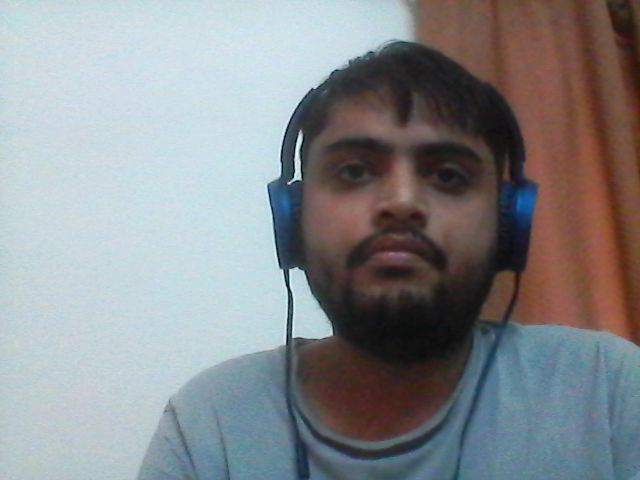

In [ ]:
from IPython.display import Image
try:
  filename = take_photo()
  print('Saved to {}'.format(filename))
  
  # Show the image which was just taken.
  display(Image(filename))
except Exception as err:
  # Errors will be thrown if the user does not have a webcam or if they do not
  # grant the page permission to access it.
  print(str(err))

In [ ]:
from google.colab.patches import cv2_imshow

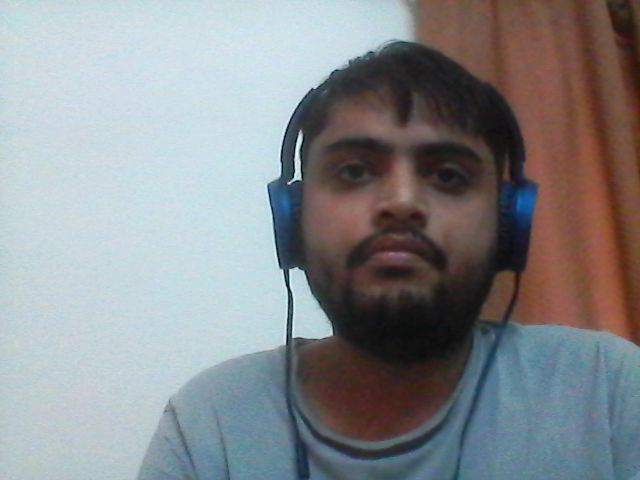

In [ ]:
img = cv2.imread('photo.jpg', cv2.IMREAD_UNCHANGED)
cv2_imshow(img)

In [ ]:
v = encoder("photo.jpg")

In [ ]:
photo_2048 = v.reshape((1,2048))

In [ ]:
caption = predict_caption(photo_2048)
print(caption)

A man with a beard and glasses and a beard is smiling .


In [ ]:
#!unzip ./drive/MyDrive/Flickr_TextData/captions.txt.zip

In [ ]:
#!pip install kaggle

In [ ]:
#from google.colab import files
#files.upload()

#!pip install -q kaggle
#!mkdir -p ~/.kaggle
#!cp kaggle.json ~/.kaggle/
#!ls ~/.kaggle
#!chmod 600 /root/.kaggle/kaggle.json

In [ ]:
#!kaggle datasets download -d adityajn105/flickr8k

In [ ]:
#!unzip flickr8k.zip

In [ ]:
#from google.colab import files
#files.upload()

In [ ]:
from IPython.display import Audio #Import Audio method from IPython's Display Class
tts = gTTS(caption) #Provide the string to convert to speech
tts.save('2.wav') #save the string converted to speech as a .wav file
sound_file = '2.wav'
Audio(sound_file, autoplay=True) 